# Compare any layer of deep nets to any region of Algonauts data

In [1]:
#########################################
# 1. IMPORT LIBRARIES & SET GLOBAL VARS #
#########################################

import os
from os.path import exists
import glob
import re
import sys
sys.path.append('../')


import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from PIL import Image
import xarray as xr

import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as transforms
import torchvision.models as models

import gdown

# Threshold used for selecting reliable voxels.
NCSNR_THRESHOLD = 0.2


from PIL import Image

from sklearn.manifold import MDS
from sklearn.decomposition import PCA


import sys

import pickle

In [2]:
# Load Algonauts data

with open('../algonauts_brain_data_joint_images_8subjects.pkl', 'rb') as f:
    brainData = pickle.load(f)

shared_images = np.load('../algonauts_joint_images_8subjects.npy')

In [132]:
avail_models = models.list_models(module=torchvision.models)
avail_models

['alexnet',
 'convnext_base',
 'convnext_large',
 'convnext_small',
 'convnext_tiny',
 'densenet121',
 'densenet161',
 'densenet169',
 'densenet201',
 'efficientnet_b0',
 'efficientnet_b1',
 'efficientnet_b2',
 'efficientnet_b3',
 'efficientnet_b4',
 'efficientnet_b5',
 'efficientnet_b6',
 'efficientnet_b7',
 'efficientnet_v2_l',
 'efficientnet_v2_m',
 'efficientnet_v2_s',
 'googlenet',
 'inception_v3',
 'maxvit_t',
 'mnasnet0_5',
 'mnasnet0_75',
 'mnasnet1_0',
 'mnasnet1_3',
 'mobilenet_v2',
 'mobilenet_v3_large',
 'mobilenet_v3_small',
 'regnet_x_16gf',
 'regnet_x_1_6gf',
 'regnet_x_32gf',
 'regnet_x_3_2gf',
 'regnet_x_400mf',
 'regnet_x_800mf',
 'regnet_x_8gf',
 'regnet_y_128gf',
 'regnet_y_16gf',
 'regnet_y_1_6gf',
 'regnet_y_32gf',
 'regnet_y_3_2gf',
 'regnet_y_400mf',
 'regnet_y_800mf',
 'regnet_y_8gf',
 'resnet101',
 'resnet152',
 'resnet18',
 'resnet34',
 'resnet50',
 'resnext101_32x8d',
 'resnext101_64x4d',
 'resnext50_32x4d',
 'shufflenet_v2_x0_5',
 'shufflenet_v2_x1_0',
 'sh

In [6]:
# Extract representation from a single network for probe inputs and save

import extract_internal_reps

modelname = 'alexnet'
weights = 'first'
image_data = test_image_data
batch_size = 32

activations = extract_internal_reps.get_model_activations(modelname, weights, image_data, batch_size=32, saverep = True)


Using cache found in /Users/sharvey/.cache/torch/hub/pytorch_vision_main
Using cache found in /Users/sharvey/.cache/torch/hub/pytorch_vision_main


Using cpu for inference
features
avgpool
classifier
0
1
2
3
4
5
6
7
8
9
10
11
12
Preprocessing pipeline:
ImageClassification(
    crop_size=[224]
    resize_size=[256]
    mean=[0.485, 0.456, 0.406]
    std=[0.229, 0.224, 0.225]
    interpolation=InterpolationMode.BILINEAR
)
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
0
32
64
96
128
160
192
224
256
288
320
352
384
416
448
480
512
544
576
608
640
672
704
736
768
800
832
864
896
928
960
992


In [ ]:
# Extract representations resulting from probe inputs image_data for a list of models, and save them individually (takes a long time)

import extract_internal_reps

# internal_reps = []
# model_2nds = []
repDict = {}

model_names = ["alexnet", "inception_v3", "vit_b_16", "swin_v2_t"]
weights = 'first'
# image_data = test_image_data[0:1000,:,:,:]
image_data = shared_images
batch_size = 32

for model in model_names:  #avail_models:
    repDict[model] = extract_internal_reps.get_model_activations(model, weights, image_data, batch_size=32, saverep = True, filename = 'algonauts_shared_images')
    print(model + " done")

In [4]:
# Load some saved representations

repDict = {}

model_names = ["alexnet", "resnet50", "vit_b_16", "swin_v2_t"]

N_models = len(model_names)
for model_name in model_names:
    with open('../reps/' + model_name + '_algonauts_shared_images.pkl', 'rb') as f:
        new_reps = pickle.load(f)
        repDict.update(new_reps)
        print(model_name)

# model_names, _ = zip(*repDict.items())
model_names = [value for value in repDict.keys()]
# internal_reps = [value[0] for value in repDict.values()]


alexnet
resnet50
vit_b_16
swin_v2_t


In [133]:
layer_names = []
internal_reps = []
layer_models = []

for model_name in model_names:
    layer_names.extend([value for value in repDict[model_name].keys()])
    internal_reps.extend([value for value in repDict[model_name].values()])
    layer_models.extend([model_name] * len([value for value in repDict[model_name].keys()]))


In [162]:
layer_names

['pixels',
 'feature.0',
 'feature.1',
 'feature.2',
 'feature.3',
 'feature.4',
 'feature.5',
 'feature.6',
 'feature.7',
 'feature.8',
 'feature.9',
 'feature.10',
 'feature.11',
 'feature.12',
 'features',
 'avgpool',
 'classifier',
 'pixels',
 'conv1',
 'bn1',
 'relu',
 'maxpool',
 'layer1',
 'layer2',
 'layer3',
 'layer4',
 'avgpool',
 'fc',
 'pixels',
 'conv_proj',
 'encoder_layer_0',
 'encoder_layer_1',
 'encoder_layer_2',
 'encoder_layer_3',
 'encoder_layer_4',
 'encoder_layer_5',
 'encoder_layer_6',
 'encoder_layer_7',
 'encoder_layer_8',
 'encoder_layer_9',
 'encoder_layer_10',
 'encoder_layer_11',
 'encoder',
 'heads',
 'pixels',
 'feature.0',
 'feature.1',
 'feature.2',
 'feature.3',
 'feature.4',
 'feature.5',
 'feature.6',
 'feature.7',
 'features',
 'norm',
 'permute',
 'avgpool',
 'flatten',
 'head',
 'Subject_0_lh_V1v',
 'Subject_1_lh_V1v',
 'Subject_2_lh_V1v',
 'Subject_3_lh_V1v',
 'Subject_4_lh_V1v',
 'Subject_5_lh_V1v',
 'Subject_6_lh_V1v',
 'Subject_7_lh_V1v',
 'Su

In [137]:
# Append some brain data to the list of representations


# areas = ['lh_FFA-1', 'rh_FFA-1', 'lh_FFA-2', 'rh_FFA-2']
# areas = ['lh_all-faces', 'rh_all-faces']
# areas = ['lh_all-words', 'rh_all-words']
# areas = ["lh_V1v", "rh_V1v", "lh_V1d", "rh_V1d"]
# areas = ['lh_OWFA', 'rh_OWFA']
# areas_both_hemi = ["OFA", "FFA-1", "FFA-2", "mTL-faces", "aTL-faces"] 

hemisphere = "lh"  # lh, rh, or both
areas_to_append = ["FFA-1"] 
fuse = True


areas = []
for area in areas_to_append:
    if hemisphere == "both":
        areas.append('lh_' + area)
        areas.append('rh_' + area)
    elif hemisphere == "lh":
        areas.append('lh_' + area)
    elif hemisphere == "rh":
        areas.append('rh_' + area)

# all_areas = ["V1v", "V1d", "V2v", "V2d", "V3v", "V3d", "hV4", "EBA", "FBA-1", "FBA-2", "mTL-bodies", "OFA", "FFA-1", "FFA-2", "mTL-faces", "aTL-faces", "OPA", "PPA", "RSC", "OWFA", "VWFA-1", "VWFA-2", "mfs-words", "mTL-words", "early", "midventral", "midlateral", "midparietal", "ventral", "lateral", "parietal", "all-prf-visual", "all-bodies", "all-faces", "all-places", "all-words", "all-streams"]
# areas = @param all_areas {allow-input: true}


for subjind in range(len(brainData)):
    for area in areas:
        if brainData[subjind][area].shape[1] == 0:
            continue
        internal_reps.append(brainData[subjind][area])
        layer_names.append("Subject_" + str(subjind) + '_' + area)
        layer_models.append("Subject_" + str(subjind))




In [138]:
# Make sure representations are flattened

internal_reps = [internal_reps[i].reshape((internal_reps[i].shape[0], np.prod(list(internal_reps[i].shape[1:])) )) for i in range(len(internal_reps))]

[internal_rep.shape for internal_rep in internal_reps]


[(872, 541875),
 (872, 193600),
 (872, 193600),
 (872, 46656),
 (872, 139968),
 (872, 139968),
 (872, 32448),
 (872, 64896),
 (872, 64896),
 (872, 43264),
 (872, 43264),
 (872, 43264),
 (872, 43264),
 (872, 9216),
 (872, 9216),
 (872, 9216),
 (872, 1000),
 (872, 541875),
 (872, 802816),
 (872, 802816),
 (872, 802816),
 (872, 200704),
 (872, 802816),
 (872, 401408),
 (872, 200704),
 (872, 100352),
 (872, 2048),
 (872, 1000),
 (872, 541875),
 (872, 150528),
 (872, 151296),
 (872, 151296),
 (872, 151296),
 (872, 151296),
 (872, 151296),
 (872, 151296),
 (872, 151296),
 (872, 151296),
 (872, 151296),
 (872, 151296),
 (872, 151296),
 (872, 151296),
 (872, 151296),
 (872, 1000),
 (872, 541875),
 (872, 393216),
 (872, 393216),
 (872, 196608),
 (872, 196608),
 (872, 98304),
 (872, 98304),
 (872, 49152),
 (872, 49152),
 (872, 49152),
 (872, 49152),
 (872, 49152),
 (872, 768),
 (872, 768),
 (872, 1000),
 (872, 710),
 (872, 599),
 (872, 853),
 (872, 585),
 (872, 538),
 (872, 299),
 (872, 491),
 (

In [ ]:
# Do PCA on deep net representations

from sklearn.manifold import MDS
from sklearn.decomposition import PCA

Npcs = 872
pca = PCA(n_components=Npcs)
reps_pcs = []

for rep in internal_reps[:]:
    if rep.shape[1] <= Npcs:
        reps_pcs.append(rep)
        print('tiny representation')
    else:
        pcs1 = pca.fit_transform(rep)
        reps_pcs.append(pcs1)
        print(np.sum(pca.explained_variance_ratio_))
    


In [43]:
import pickle

with open('internal_reps_PCA_872_alexnet_inception_v3_vit_b_16_swin_v2_t.pkl', 'wb') as fp:
    pickle.dump(reps_pcs, fp)

# np.savez('internal_reps_PCA_872_alexnet_inception_v3_vit_b_16_swin_v2_t.npz', reps_pcs)

In [135]:
import pickle

with open ('internal_reps_PCA_872_alexnet_inception_v3_vit_b_16_swin_v2_t.pkl', 'rb') as fp:
    DNNs_reps_pcs = pickle.load(fp)

In [140]:
import metrics 

dd = metrics.LinearDecodingSimilarityMulti(center_columns=True, a = 0, b = 1, whiten = False, alpha = 0.5)
cached = dd.cache(internal_reps, returnGinv=False) # this part takes a long time
# cached = dd.cache(reps_pcs, returnGinv=False) # this part takes a long time
np.savez('../cached_matrices/Kx_cache_alexnet_resnet50_vit_b_16_swin_v2_t_algodata_subj1-8_lh_V1v_and_FFA-1_a0b1_all_layers.npz', cached, layer_names)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
Done caching.


In [141]:
# load previously computed cache

# loaded_cache = np.load('../cached_matrices/Kx_cache_alexnet_inception_v3_vit_b_16_swin_v2_t_algodata_subj1-8_rh_ventral_a0b1_all_layers.npz')
loaded_cache = np.load('../cached_matrices/Kx_cache_alexnet_resnet50_vit_b_16_swin_v2_t_algodata_subj1-8_lh_V1v_and_FFA-1_a0b1_all_layers.npz')

# cached = loaded_cache
cached = loaded_cache["arr_0"]
layer_names = loaded_cache["arr_1"]
layer_names = [str(layer_name) for layer_name in layer_names]

In [113]:
# Define decoding target

human = 0
area = "lh_FFA-1"
Cz = (1/brainData[human][area].shape[1]) * brainData[human][area] @ brainData[human][area].T

# random_rep = np.random.normal(loc=0.0, scale=1.0, size=(brainData[human][area].shape[0], brainData[human][area].shape[1]))
# Cz = (1/brainData[human][area].shape[1]) * random_rep @ random_rep.T

# Cz = np.identity(brainData[human][area].shape[0])

In [114]:
cached_norm = np.zeros(np.shape(cached))
for i in range(np.shape(cached)[0]):
    cached_norm[i] = cached[i]/(np.sqrt(np.trace(cached[i]@cached[i]@Cz)))

In [115]:
# Compute ADS with a human region as the target

# bs = [1e-6, 1e-5, 1e-4, 1e-3, 1e-2, 0.1, 1, 10, 100, 1000, 10000, 1e5, 1e6]

import metrics

dd = metrics.LinearDecodingSimilarityMulti(center_columns=True, a = 0, b = 1, whiten = False, alpha = 0.5)

# DSscores = dd.score(internal_reps,Cz,cached_norm)
DSdists = dd.distance(internal_reps,Cz,cached_norm)

DSscores = dd.score(internal_reps,Cz,cached)
# DSdists = dd.distance(internal_reps,Cz,cached)

# DSscores = dd.score(reps_pcs,Cz,cached)
# DSdists = dd.distance(reps_pcs,Cz,cached)

# DSscores = dd.score(reps_pcs,Cz,cached_norm)
# DSdists = dd.distance(reps_pcs,Cz,cached_norm)

# DSscores = dd.score(reps_pcs,Cz,cached)


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66


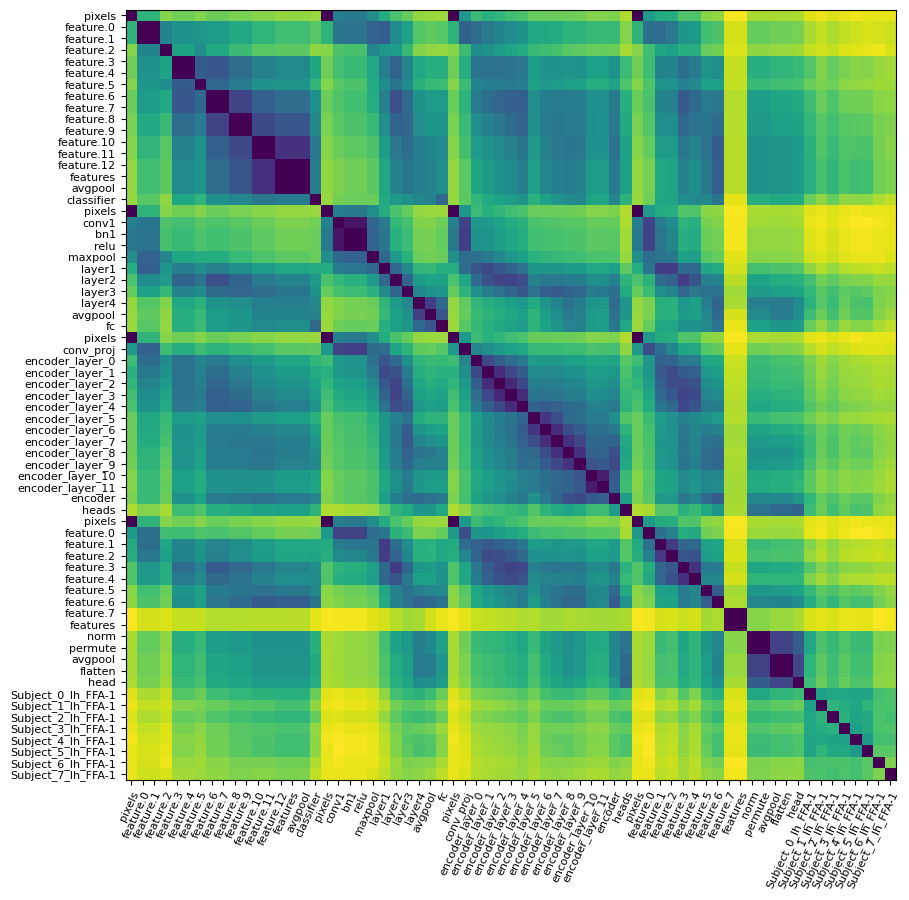

In [116]:
for i in range(len(DSscores)):
    DSscores[i,i] = 1

DSscores[DSscores >1] = 1

# Look at the distance matrix
dists_ds = np.arccos(DSscores)
# dists_ds = DSdists

# Create the heatmap
fig, ax = plt.subplots(figsize= (10,10))
im = ax.imshow(dists_ds)

# Define custom tick locations and labels
x_ticks = np.arange(dists_ds.shape[0])
x_labels = layer_names # Custom labels

y_ticks = np.arange(dists_ds.shape[1])
y_labels = layer_names

# Set x-axis ticks and labels
ax.set_xticks(x_ticks)
# ax.set_xticks([])
ax.set_xticklabels(x_labels)

# Set y-axis ticks and labels
ax.set_yticks(y_ticks)
# ax.set_yticks([])
ax.set_yticklabels(y_labels)

# Add a colorbar
# cbar = ax.figure.colorbar(im, ax=ax)

# Rotate the tick labels and set their alignment
# plt.setp(ax.get_xticklabels(), rotation=60, ha="right",
#          rotation_mode="anchor")

plt.setp(ax.get_xticklabels(),
         fontsize=8,
         rotation=65,
         ha='right', # horizontal alignment
         color='black', 
        rotation_mode="anchor")

plt.setp(ax.get_yticklabels(),
         fontsize=8,
         rotation=0,
         ha='right', # horizontal alignment
         color='black', 
        rotation_mode="anchor")

# Add title
# ax.set_title("Trained weights")

# plt.savefig('dist_mat_acADS_random_weights.pdf',bbox_inches='tight')

# Display the plot
plt.show()

In [117]:
# ADS Embedding

from sklearn.manifold import MDS
from sklearn.decomposition import PCA

embedding = MDS(n_components=100, metric= True, eps = 0.00001, normalized_stress='auto', dissimilarity='precomputed')
Z = embedding.fit_transform(np.abs(np.real(dists_ds)))
print(embedding.stress_)

pca = PCA(n_components=3)
pcs1 = pca.fit_transform(Z)
np.sum(pca.explained_variance_ratio_)

0.030432157274339885


np.float64(0.5572916920557858)

In [118]:
import plotly
import plotly.graph_objs as go

# Configure Plotly to be rendered inline in the notebook.
plotly.offline.init_notebook_mode()

Nlayers1 = len(repDict[model_names[0]])
# Nlayers2 = len(repDict[model_names[1]])
Nhumans = 8

# Configure the trace.
trace1 = go.Scatter3d(
    x=pcs1[:Nlayers1,0],  # <-- Put your data instead
    y=pcs1[:Nlayers1,1],  # <-- Put your data instead
    z=pcs1[:Nlayers1,2],  # <-- Put your data instead
    mode='markers+text',
    marker={
        'size': 10,
        'opacity': 0.8
    }, text=layer_names[:Nlayers1]
)


# # Configure the trace.
# trace2 = go.Scatter3d(
#     x=pcs1[Nlayers1:Nlayers1+Nlayers2,0],  # <-- Put your data instead
#     y=pcs1[Nlayers1:Nlayers1+Nlayers2,1],  # <-- Put your data instead
#     z=pcs1[Nlayers1:Nlayers1+Nlayers2,2],  # <-- Put your data instead
#     mode='markers+text',
#     marker={
#         'size': 10,
#         'opacity': 0.8
#     }, text=layer_names[Nlayers1:Nlayers1+Nlayers2]
# )

# # Configure the trace.
# trace3 = go.Scatter3d(
#     x=pcs1[Nlayers1+Nlayers2:-Nhumans,0],  # <-- Put your data instead
#     y=pcs1[Nlayers1+Nlayers2:-Nhumans,1],  # <-- Put your data instead
#     z=pcs1[Nlayers1+Nlayers2:-Nhumans,2],  # <-- Put your data instead
#     mode='markers+text',
#     marker={
#         'size': 10,
#         'opacity': 0.8
#     }, text=layer_names[Nlayers1+Nlayers2:-Nhumans]
# )

# Configure the trace.
trace4 = go.Scatter3d(
    x=pcs1[-Nhumans:,0],  # <-- Put your data instead
    y=pcs1[-Nhumans:,1],  # <-- Put your data instead
    z=pcs1[-Nhumans:,2],  # <-- Put your data instead
    mode='markers+text',
    marker={
        'size': 10,
        'opacity': 0.8
    }, text=layer_names[-Nhumans:]
)

# Configure the layout.
layout = go.Layout(
    margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
)

# data = [trace1, trace2, trace3, trace4]
data = [trace1, trace4]


plot_figure = go.Figure(data=data, layout=layout)

# Render the plot.
plotly.offline.iplot(plot_figure)

/tmp/ipykernel_524485/4042708395.py:59: UserWarning:

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.



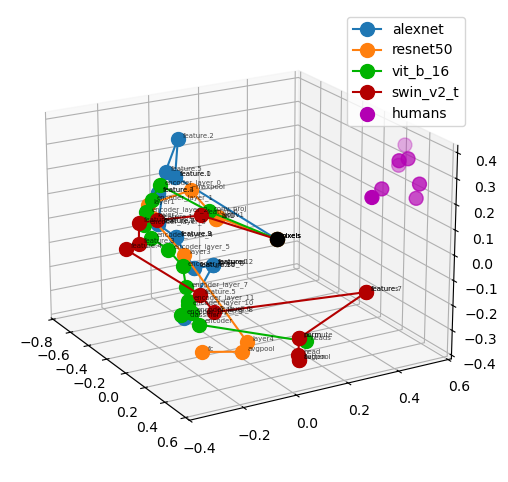

In [134]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from matplotlib.animation import FuncAnimation

# Create the figure and axes object
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')

Nlayers1 = len(repDict[model_names[0]])
Nlayers2 = len(repDict[model_names[1]])
Nlayers3 = len(repDict[model_names[2]])
Nlayers4 = len(repDict[model_names[3]])
Nhumans = 8

num_points = len(pcs1)
x = pcs1[:Nlayers1,0]
y = pcs1[:Nlayers1,1]
z = pcs1[:Nlayers1,2]

x1 = pcs1[Nlayers1:Nlayers1+Nlayers2,0],  # <-- Put your data instead
y1 = pcs1[Nlayers1:Nlayers1+Nlayers2,1],  # <-- Put your data instead
z1 = pcs1[Nlayers1:Nlayers1+Nlayers2,2],

x2 = pcs1[Nlayers1+Nlayers2:Nlayers1+Nlayers2+Nlayers3,0],  # <-- Put your data instead
y2 = pcs1[Nlayers1+Nlayers2:Nlayers1+Nlayers2+Nlayers3,1],  # <-- Put your data instead
z2 = pcs1[Nlayers1+Nlayers2:Nlayers1+Nlayers2+Nlayers3,2],

x3 = pcs1[Nlayers1+Nlayers2+Nlayers3:-Nhumans,0],  # <-- Put your data instead
y3 = pcs1[Nlayers1+Nlayers2+Nlayers3:-Nhumans,1],  # <-- Put your data instead
z3 = pcs1[Nlayers1+Nlayers2+Nlayers3:-Nhumans,2],

x4 = pcs1[-Nhumans:,0]
y4 = pcs1[-Nhumans:,1]
z4 = pcs1[-Nhumans:,2]

# x4 = pcs1[-Nhumans:,0]
# y4 = pcs1[-Nhumans:,1]
# z4 = pcs1[-Nhumans:,2]

 

alpha_arr1 = np.linspace(0.2,1,Nlayers1) 
alpha_arr2 = np.linspace(0.2,1,Nlayers2) 
c1 = [(0, 0, alpha) for alpha in alpha_arr1]
c2 = [(0, alpha, 0) for alpha in alpha_arr2]

# Create the scatter plot
# scatter1 = ax.plot(x, y, z, '.-',c=[0,0,0.7])
# scatter2 = ax.plot(x1, y1, z1, '.-',c=[0,0.7,0])
# scatter3 = ax.plot(x2, y2, z2, '.-',c=[0.7,0,0])
# scatter4 = ax.plot(x3, y3, z3, '.-',c=[0.7,0.4,0])
# scatter5 = ax.scatter(x4, y4, z4, '.-',c=[0.7,0,0.7])

scatter1 = ax.plot(x, y, z, '.-', label=model_names[0] ,markersize=20)
scatter2 = ax.plot(x1, y1, z1, '.-',label=model_names[1], markersize=20)
scatter3 = ax.plot(x2, y2, z2, '.-',c=[0,0.7,0],label=model_names[2], markersize=20)
scatter4 = ax.plot(x3, y3, z3, '.-',c=[0.7,0,0],label=model_names[3], markersize=20)
scatter5 = ax.scatter(x4, y4, z4, '.-',c=[0.7,0,0.7],s=100, label='humans')
scatterp = ax.scatter(x3[0][0], y3[0][0], z3[0][0], s=100,color=[0,0,0],alpha=1)


# scatter1 = ax.scatter(x, y, z,c=c1, alpha=0.7)
# scatter2 = ax.scatter(xr, yr, zr,s=100,c=c2, alpha=0.7)
# scatter3 = ax.scatter(xh, yh, zh,s=100,c=[0.7,0,0], alpha=0.7)

for i, txt in enumerate(layer_names[:-8]):
    ax.text(pcs1[i,0], pcs1[i,1]+0.02,pcs1[i,2],txt,fontsize=5,alpha=0.7)

# ax.text(pcs1[-4,0], pcs1[-4,1]+0.02,pcs1[-4,2],"Human 1 V2",fontsize=9, alpha=0.9)
# ax.text(pcs1[-3,0], pcs1[-3,1]+0.02,pcs1[-3,2],"Human 2 V2",fontsize=9, alpha=0.9)
# ax.text(pcs1[-2,0], pcs1[-2,1]+0.02,pcs1[-2,2],"Human 5 V2",fontsize=9, alpha=0.9)
# ax.text(pcs1[-1,0], pcs1[-1,1]+0.02,pcs1[-1,2],"Human 7 V2",fontsize=9, alpha=0.9)


# for i, txt in enumerate(["Human 1", "Human 2"]):
#     ax.text(pcs1[i,0], pcs1[i,1],pcs1[i,2],txt,fontsize=10)

# Define the animation function
def rotate(angle):
    ax.view_init(azim=angle)
    return ax.scatter,

ax.view_init(elev=20, azim=330) # Elevation and Azimuth angles
plt.legend()

# # # Create the animation
# num_frames = 360  # Number of frames for a full rotation
# animation = FuncAnimation(fig, rotate, frames=num_frames, interval=20, blit=False)

# Save the animation as a video
# animation.save('../rotating_videos/ADS_rotating_scatter_plot_alexnet_resnet50_vit_b_16_8subjects_target_lh_V1v_a0b1_trained_weights_withlines_kernelNormed.mp4', writer='ffmpeg', fps=30, dpi=300)

# plt.savefig('ads_scatter_plot_poster_trained_weights_four_networks_trajectories_lh_FFA-1_both.pdf')

plt.show()

## Frechet Mean and variance

In [25]:
import metrics

loaded_cache = np.load('../cached_matrices/Kx_cache_alexnet_algodata_subj1-8_V1v_rh_a0b1_all_layers.npz')

# cached = loaded_cache
cached = loaded_cache["arr_0"]
layer_names = loaded_cache["arr_1"]
layer_names = [str(layer_name) for layer_name in layer_names]

human = 0
area = "rh_V1v"
Cz = (1/brainData[human][area].shape[1]) * brainData[human][area] @ brainData[human][area].T

cached_norm = np.zeros(np.shape(cached))
for i in range(np.shape(cached)[0]):
    cached_norm[i] = cached[i]/(np.sqrt(np.trace(cached[i]@cached[i]@Cz)))

In [51]:
import dsutils

frec = dsutils.Frechet()

# fmean = frec.mean(cached_norm[-8:], Cz)
# Kbar = np.real(fmean)
fvar = frec.variance(cached_norm[:], cached_norm[-8], Cz)
# print(fvar)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24


In [52]:
fvar

np.float64(25.123200431574432)

In [34]:
# Compute ADS with a human region as the target

# bs = [1e-6, 1e-5, 1e-4, 1e-3, 1e-2, 0.1, 1, 10, 100, 1000, 10000, 1e5, 1e6]

import metrics

human = 0
area = "rh_V1v"
Cz = (1/brainData[human][area].shape[1]) * brainData[human][area] @ brainData[human][area].T

# random_rep = np.random.normal(loc=0.0, scale=1.0, size=(brainData[human][area].shape[0], brainData[human][area].shape[1]))
# Cz = (1/brainData[human][area].shape[1]) * random_rep @ random_rep.T

# Cz = np.identity(brainData[human][area].shape[0])

Kbar_expanded = np.expand_dims(Kbar, axis=0)
cached_with_mean = np.concatenate((cached_norm, Kbar_expanded), axis=0)

dd = metrics.LinearDecodingSimilarityMulti(center_columns=True, a = 0, b = 1, whiten = False, alpha = 0.5)
# DSscores = dd.score(internal_reps,Cz,cached)
DSdists = dd.distance(internal_reps,Cz,cached_with_mean)

# DSscores = dd.score(reps_pcs,Cz,cached)
# DSdists = dd.distance(reps_pcs,Cz,cached)

# DSscores = dd.score(reps_pcs,Cz,cached)


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25


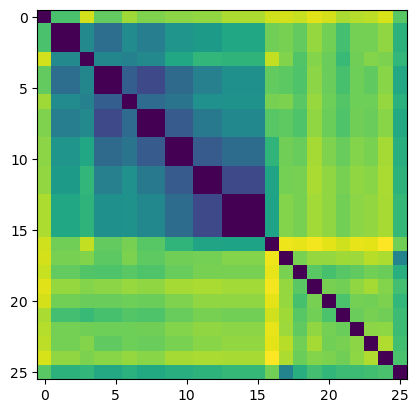

In [35]:
plt.imshow(DSdists)

In [30]:
# ADS Embedding

from sklearn.manifold import MDS
from sklearn.decomposition import PCA

embedding = MDS(n_components=100, metric= True, eps = 0.00001, normalized_stress='auto', dissimilarity='precomputed')
Z = embedding.fit_transform(np.abs(np.real(DSdists)))
print(embedding.stress_)

pca = PCA(n_components=3)
pcs1 = pca.fit_transform(Z)
np.sum(pca.explained_variance_ratio_)

0.0027636813568151447


np.float64(0.4813065207272244)

In [31]:
import plotly
import plotly.graph_objs as go

# Configure Plotly to be rendered inline in the notebook.
plotly.offline.init_notebook_mode()

Nlayers1 = len(repDict[model_names[0]])
# Nlayers2 = len(repDict[model_names[1]])
Nhumans = 9

# Configure the trace.
trace1 = go.Scatter3d(
    x=pcs1[:Nlayers1,0],  # <-- Put your data instead
    y=pcs1[:Nlayers1,1],  # <-- Put your data instead
    z=pcs1[:Nlayers1,2],  # <-- Put your data instead
    mode='markers+text',
    marker={
        'size': 10,
        'opacity': 0.8
    }, text=layer_names[:Nlayers1]
)


# # Configure the trace.
# trace2 = go.Scatter3d(
#     x=pcs1[Nlayers1:Nlayers1+Nlayers2,0],  # <-- Put your data instead
#     y=pcs1[Nlayers1:Nlayers1+Nlayers2,1],  # <-- Put your data instead
#     z=pcs1[Nlayers1:Nlayers1+Nlayers2,2],  # <-- Put your data instead
#     mode='markers+text',
#     marker={
#         'size': 10,
#         'opacity': 0.8
#     }, text=layer_names[Nlayers1:Nlayers1+Nlayers2]
# )

# # Configure the trace.
# trace3 = go.Scatter3d(
#     x=pcs1[Nlayers1+Nlayers2:-Nhumans,0],  # <-- Put your data instead
#     y=pcs1[Nlayers1+Nlayers2:-Nhumans,1],  # <-- Put your data instead
#     z=pcs1[Nlayers1+Nlayers2:-Nhumans,2],  # <-- Put your data instead
#     mode='markers+text',
#     marker={
#         'size': 10,
#         'opacity': 0.8
#     }, text=layer_names[Nlayers1+Nlayers2:-Nhumans]
# )

# Configure the trace.
trace4 = go.Scatter3d(
    x=pcs1[-Nhumans:,0],  # <-- Put your data instead
    y=pcs1[-Nhumans:,1],  # <-- Put your data instead
    z=pcs1[-Nhumans:,2],  # <-- Put your data instead
    mode='markers+text',
    marker={
        'size': 10,
        'opacity': 0.8
    }, text=layer_names[-Nhumans:]
)

# Configure the layout.
layout = go.Layout(
    margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
)

# data = [trace1, trace2, trace3, trace4]
data = [trace1, trace4]


plot_figure = go.Figure(data=data, layout=layout)

# Render the plot.
plotly.offline.iplot(plot_figure)

## Max/min metrics

In [596]:
model_names

['alexnet', 'resnet50', 'vit_b_16', 'swin_v2_t']

In [429]:
layer_names

['pixels',
 'feature.0',
 'feature.1',
 'feature.2',
 'feature.3',
 'feature.4',
 'feature.5',
 'feature.6',
 'feature.7',
 'feature.8',
 'feature.9',
 'feature.10',
 'feature.11',
 'feature.12',
 'features',
 'avgpool',
 'classifier',
 'pixels',
 'conv1',
 'bn1',
 'relu',
 'maxpool',
 'layer1',
 'layer2',
 'layer3',
 'layer4',
 'avgpool',
 'fc',
 'pixels',
 'conv_proj',
 'encoder_layer_0',
 'encoder_layer_1',
 'encoder_layer_2',
 'encoder_layer_3',
 'encoder_layer_4',
 'encoder_layer_5',
 'encoder_layer_6',
 'encoder_layer_7',
 'encoder_layer_8',
 'encoder_layer_9',
 'encoder_layer_10',
 'encoder_layer_11',
 'encoder',
 'heads',
 'pixels',
 'feature.0',
 'feature.1',
 'feature.2',
 'feature.3',
 'feature.4',
 'feature.5',
 'feature.6',
 'feature.7',
 'features',
 'norm',
 'permute',
 'avgpool',
 'flatten',
 'head',
 'Subject_0_lh_V1v',
 'Subject_1_lh_V1v',
 'Subject_2_lh_V1v',
 'Subject_3_lh_V1v',
 'Subject_4_lh_V1v',
 'Subject_5_lh_V1v',
 'Subject_6_lh_V1v',
 'Subject_7_lh_V1v',
 'Su

In [265]:
model_names

['alexnet', 'resnet50', 'vit_b_16', 'swin_v2_t']

In [164]:
cached_norm = np.zeros(np.shape(cached))
for i in range(np.shape(cached)[0]):
    cached_norm[i] = cached[i]/(np.sqrt(np.trace(cached[i]@cached[i])))

In [1058]:
ind1 = -22
ind2 = -8

# metric_type = 'similarity'
metric_type = 'distance'


KX = cached_norm[ind1]
KY = cached_norm[ind2]

if metric_type == 'similarity':
    A = (1/2)*(KX@KY + KY@KX)
elif metric_type == 'distance':
    A = (KX - KY)@(KX - KY)
else:
    print('check metric type')

# A = KX

vals, vecs = np.linalg.eig(A)

idx = vals.argsort()[::-1]   
vals = vals[idx]
vecs = vecs[:,idx]

print(layer_names[ind1])
print(layer_names[ind2])

features
Subject_0_lh_FFA-1


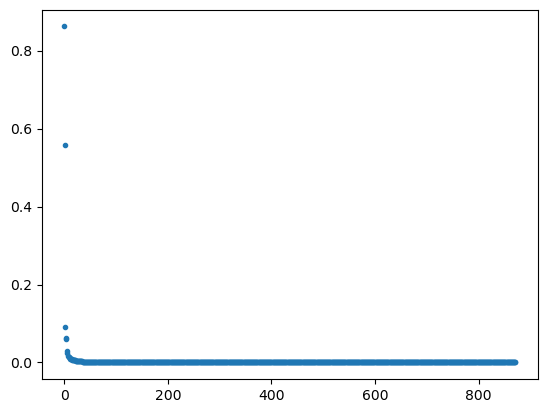

In [1059]:
plt.plot(vals,'.')

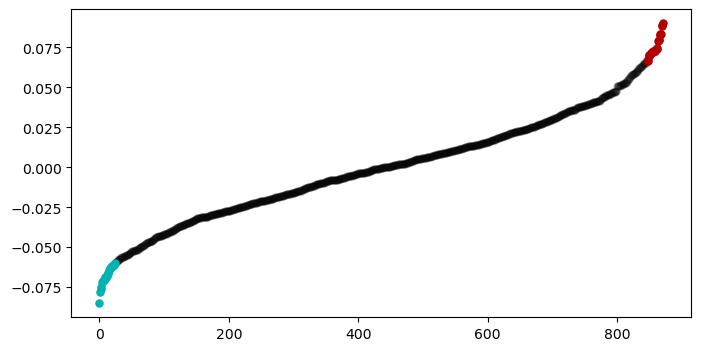

In [1060]:
# Pick an eigenvector z

zind = 1
sorted_img_idx = vecs[:,zind].argsort()[::-1]

points = np.sort(vecs[:,zind])

plt.figure(figsize=(8, 4))
plt.plot(points,'.', color=[0,0,0], alpha=0.2, markersize=10)
plt.plot(list(range(847, 872)), points[-25:],'.', color=[0.7, 0, 0], markersize=10)
plt.plot(list(range(25)), points[:25],'.', color=[0, 0.7, 0.7], markersize=10)
# plt.savefig('maxdist_topeigenvec.pdf', dpi=500)

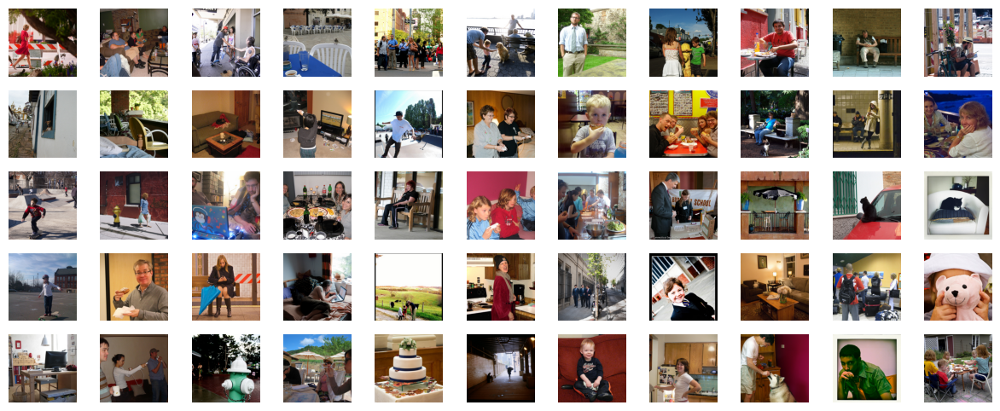

In [1061]:
import matplotlib.pyplot as plt

nimgs = 55
ncols = 11
nrows = int(np.ceil(nimgs/ncols))

fig, axes = plt.subplots(nrows, ncols, figsize=(15,6))
ind = 0

for row in range(nrows):
    for column in range(ncols):
        if ind == nimgs:
            break
        else:
            # image = test_image_data[sorted_img_idx[ind],:,:,:]
            image = shared_images[sorted_img_idx[ind],:,:,:]
            ax = axes[row, column]
            # ax.set_title(f"Image ({row}, {column})")
            ax.axis('off')
            ax.imshow(image)
            ind += 1

# plt.savefig('maxmin_image_tiles/distance_maxweights_' + model_names[ind1] + '_' + model_names[ind2] + '_eigvec' + str(zind) + '.pdf')
# plt.savefig('maxdist_image_tile_topweights_top55.pdf', dpi=500)

plt.show()



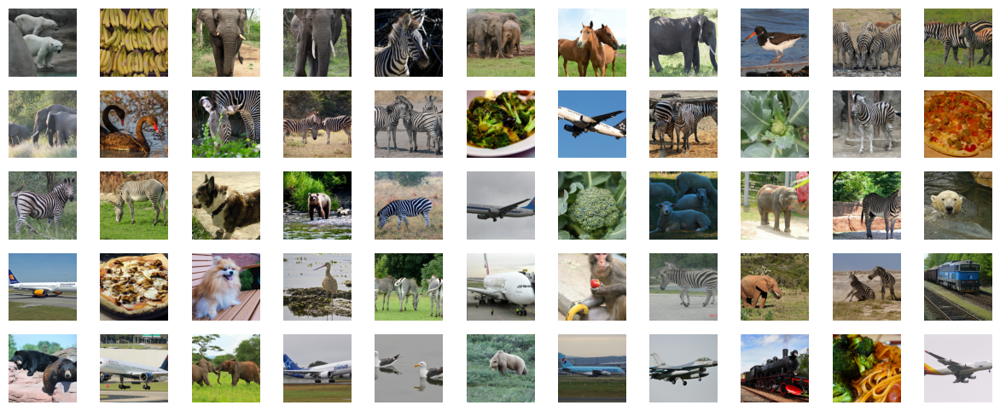

In [1062]:
import matplotlib.pyplot as plt

nimgs = 55
ncols = 11
nrows = int(np.ceil(nimgs/ncols))

fig, axes = plt.subplots(nrows, ncols, figsize=(15,6))
ind = -1

for row in range(nrows):
    for column in range(ncols):
        if ind == nimgs:
            break
        else:
            # image = test_image_data[sorted_img_idx[ind],:,:,:]
            image = shared_images[sorted_img_idx[ind],:,:,:]
            ax = axes[row, column]
            # ax.set_title(f"Image ({row}, {column})")
            ax.axis('off')
            ax.imshow(image)
            ind -= 1

# plt.savefig('maxmin_image_tiles/distance_minweights_' + model_names[ind1] + '_' + model_names[ind2] + '_eigvec' + str(zind) + '.pdf')
# plt.savefig('maxdist_image_tile_bottomweights.pdf', dpi=500)

plt.show()

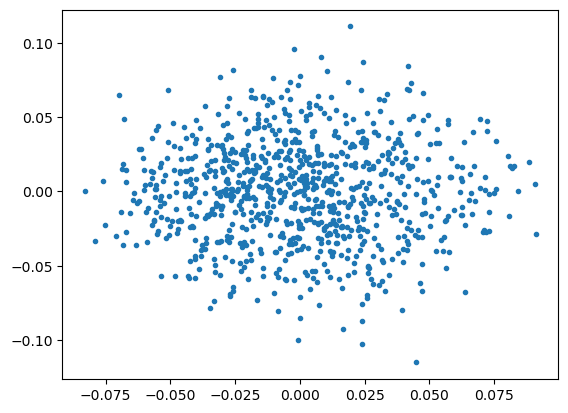

In [1056]:
plt.plot(vecs[:,0],vecs[:,1],'.')

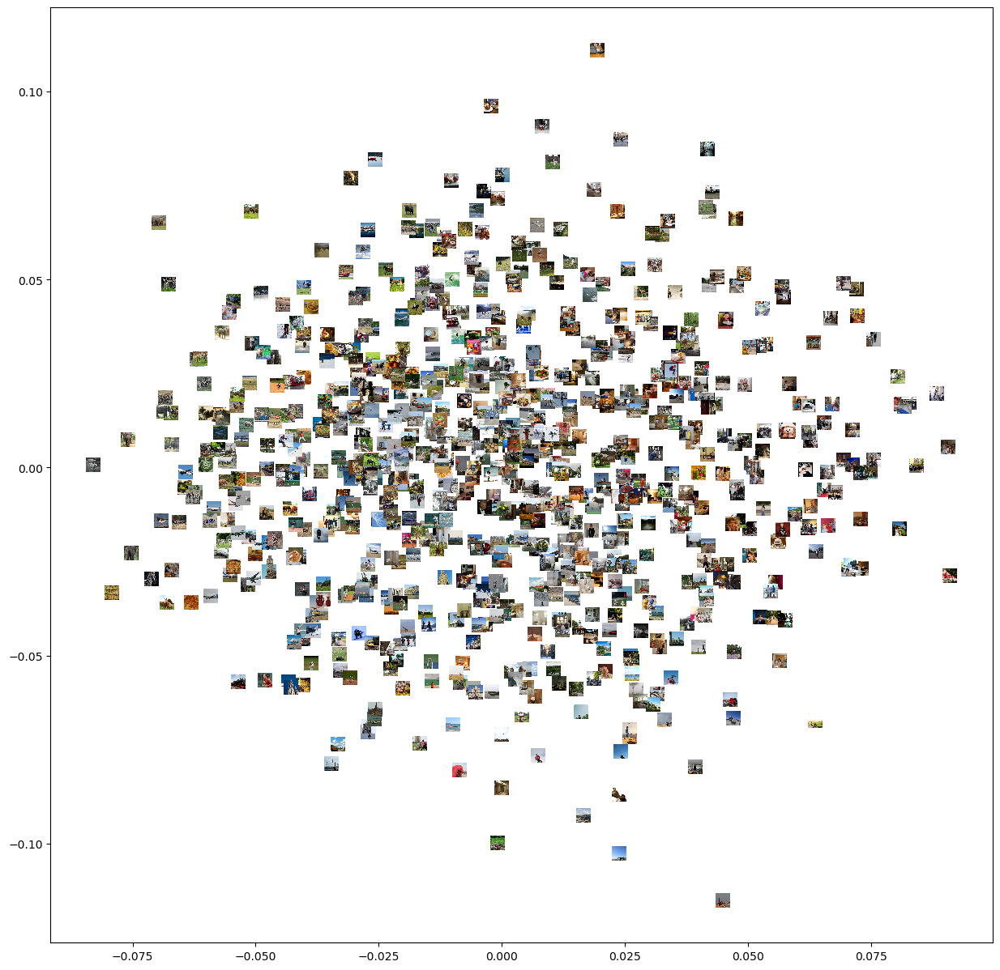

In [1057]:
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

def getImage(path, zoom=1):
    return OffsetImage(plt.imread(path), zoom=zoom)



# images = [test_image_data[i,:,:,:] for i in range(1000)]
images = [shared_images[i,:,:,:] for i in range(len(shared_images))]


x = vecs[:,0]
y = vecs[:,1]

fig, ax = plt.subplots(figsize=(15,15))
ax.scatter(x, y) 

zoom=0.03

for x0, y0, imgdata in zip(x, y,images):
    img = OffsetImage(imgdata, zoom=zoom)
    # img = Image.fromarray(imgdata, 'RGB')
    ab = AnnotationBbox(img, (x0, y0), frameon=False)
    ax.add_artist(ab)

# plt.savefig('../maxmin_image_tiles/top2eigenvecs_'+ metric_type +'_a0b1_'+ layer_model[ind1] + '_' + layer_names[ind1] + '_' + layer_model[ind2] + '_' + layer_names[ind2] + '.pdf', dpi=500)
# plt.savefig('presentation_image_tiles_1.pdf', dpi=500)
    

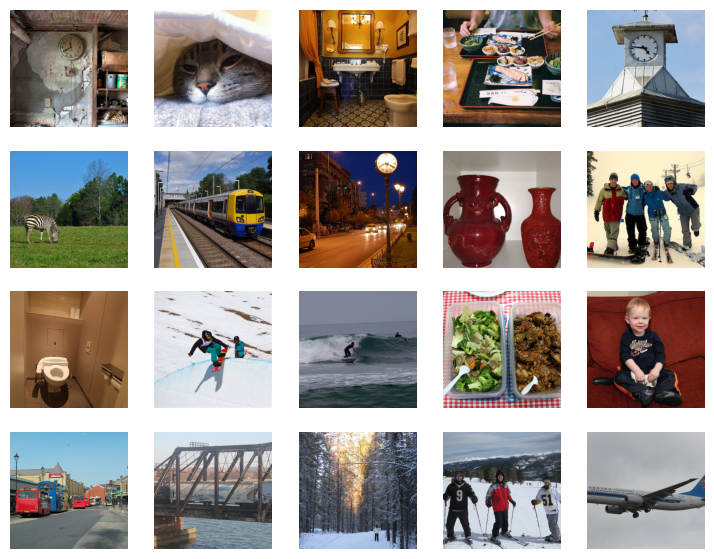

In [866]:
import matplotlib.pyplot as plt

nimgs = 20
ncols = 5
nrows = int(np.ceil(nimgs/ncols))

fig, axes = plt.subplots(nrows, ncols, figsize=(9,7))
ind = 0

for row in range(nrows):
    for column in range(ncols):
        if ind == nimgs:
            break
        else:
            # image = test_image_data[sorted_img_idx[ind],:,:,:]
            image = shared_images[np.random.randint(872),:,:,:]
            ax = axes[row, column]
            # ax.set_title(f"Image ({row}, {column})")
            ax.axis('off')
            ax.imshow(image)
            ind += 1
            
# plt.subplots_adjust(left=0.1, top=0.5, bottom=0.1, wspace=0.0, hspace=0.1)

# plt.savefig('maxmin_image_tiles/distance_maxweights_' + model_names[ind1] + '_' + model_names[ind2] + '_eigvec' + str(zind) + '.pdf')

plt.savefig('random_images_2.pdf', dpi=500)
plt.show()



In [535]:
np.random.randint(872)

5